In [222]:
import pandas as pd
import numpy as np
import datetime
import json
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas
import plotly.offline as pyo
import plotly.express as px
import plotly.graph_objects as go
import warnings

In [223]:
#pd.set_option('display.max_colwidth', None)
#pd.set_option('display.max_rows', None)
warnings.filterwarnings("ignore")

## motivation

### Aim to find relationship between each feature and price

## Data Overview

In [224]:
airbnblist = pd.read_csv('listings.csv')
airbnblist.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,11156,An Oasis in the City,40855,Colleen,NaN,Sydney,-33.86934,151.22688,Private room,65,90,196,2020-03-13,1.33,1,364,0,NaN
1,14250,Manly Harbour House,55948,Heidi,NaN,Manly,-33.80093,151.26172,Entire home/apt,470,2,3,2021-06-01,0.04,2,192,1,Exempt
2,15253,Unique Designer Rooftop Apartment in City Loca...,59850,Morag,NaN,Sydney,-33.87964,151.21680,Private room,88,2,389,2021-12-25,3.23,1,352,24,PID-STRA-24061-7
3,44545,Sunny Darlinghurst Warehouse Apartment,112237,Atari,NaN,Sydney,-33.87888,151.21439,Entire home/apt,130,90,76,2020-01-03,0.56,1,0,0,NaN
4,58506,"Studio Yindi @ Mosman, Sydney",279955,John,NaN,Mosman,-33.81927,151.23652,Entire home/apt,150,2,303,2022-01-07,2.26,1,239,18,PID-STRA-6093


In [225]:
airbnblist.shape

(20878, 18)

In [226]:
airbnblistall = pd.read_csv('listingsall.csv')
airbnblistall.shape

(20878, 74)

In [227]:
airbnbreview = pd.read_csv('reviews.csv')
airbnbreview.head()

,listing_id,date
0,11156,2009-12-05
1,11156,2010-03-31
2,11156,2010-05-14
3,11156,2010-11-17
4,11156,2010-12-11


In [228]:
airbnbreview.shape

(377203, 2)

In [229]:
airbnbreviewall = pd.read_csv('reviewsall.csv')
airbnbreviewall.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,11156,19220,2009-12-05,52946,Jeff,Colleen was friendly and very helpful regardin...
1,11156,32592,2010-03-31,99382,Michael,"Great place, centrally located, easy walk to t..."
2,11156,42280,2010-05-14,105797,Marina,Colleen is very friendly and helpful. The apar...
3,11156,140942,2010-11-17,259213,Sigrid,Dear Colleen!\r<br/>My friend Diemut from Germ...
4,11156,151966,2010-12-11,273389,Eduardo,"Lovely, interesting chats and very helpful giv..."


In [230]:
airbnbreviewall.shape

(377203, 6)

### Based on the overview of the above data, we choose listing.csv to do our analysis, and other csv doucuments as the relavant data set to provide information which we need.

In [231]:
airbnblist.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20878 entries, 0 to 20877
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              20878 non-null  int64  
 1   name                            20871 non-null  object 
 2   host_id                         20878 non-null  int64  
 3   host_name                       20875 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   20878 non-null  object 
 6   latitude                        20878 non-null  float64
 7   longitude                       20878 non-null  float64
 8   room_type                       20878 non-null  object 
 9   price                           20878 non-null  int64  
 10  minimum_nights                  20878 non-null  int64  
 11  number_of_reviews               20878 non-null  int64  
 12  last_review                     

In [232]:
airbnblist.isnull().sum()

id                                    0
name                                  7
host_id                               0
host_name                             3
neighbourhood_group               20878
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                        5544
reviews_per_month                  5544
calculated_host_listings_count        0
availability_365                      0
number_of_reviews_ltm                 0
license                           13135
dtype: int64

## Data Preprocession

In [233]:
df_airbnblist = airbnblist.copy()

## Data Analysis

### From the data overview above, we can choose price, neighbourhood, room type, number of reviews and do some analysis focus on relationship between features and price.

In [234]:
df_list = df_airbnblist[['id','name','neighbourhood','room_type','number_of_reviews','price']]

In [235]:
df_list.head()

,id,name,neighbourhood,room_type,number_of_reviews,price
0,11156,An Oasis in the City,Sydney,Private room,196,65
1,14250,Manly Harbour House,Manly,Entire home/apt,3,470
2,15253,Unique Designer Rooftop Apartment in City Loca...,Sydney,Private room,389,88
3,44545,Sunny Darlinghurst Warehouse Apartment,Sydney,Entire home/apt,76,130
4,58506,"Studio Yindi @ Mosman, Sydney",Mosman,Entire home/apt,303,150


### Market size in different area

In [236]:
market_size = df_list[['neighbourhood','name']]
market_size.head()

,neighbourhood,name
0,Sydney,An Oasis in the City
1,Manly,Manly Harbour House
2,Sydney,Unique Designer Rooftop Apartment in City Loca...
3,Sydney,Sunny Darlinghurst Warehouse Apartment
4,Mosman,"Studio Yindi @ Mosman, Sydney"


In [237]:
market_size = market_size.groupby('neighbourhood').count().reset_index()
market_size.head()

,neighbourhood,name
0,Ashfield,167
1,Auburn,276
2,Bankstown,130
3,Blacktown,186
4,Botany Bay,400


In [238]:
market_size_pie = market_size.copy()
market_size_pie.rename(columns={'name':'Market Size', 'neighbourhood':'Location'}, inplace = True)
market_size_pie.head()

,Location,Market Size
0,Ashfield,167
1,Auburn,276
2,Bankstown,130
3,Blacktown,186
4,Botany Bay,400


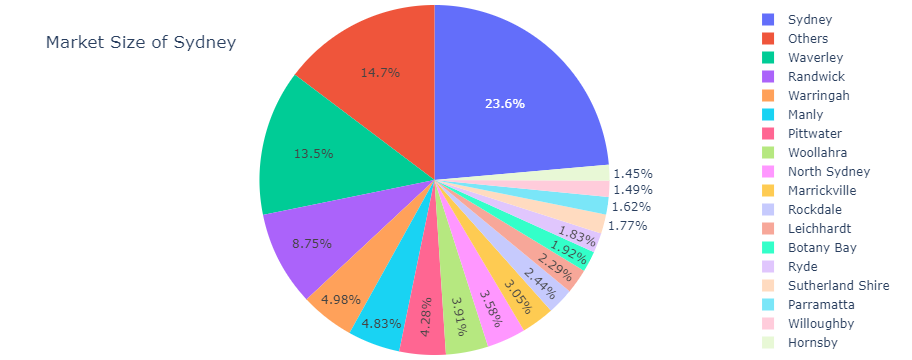

In [239]:
market_size_pie.loc[market_size_pie['Market Size'] < 300, 'Location'] = 'Others' # Represent only large countries
fig = px.pie(market_size_pie, values='Market Size', names='Location')
fig.update_layout(margin=dict(t=0, b=0, l=0, r=0), title_text='Market Size of Sydney', title_y=0.9)
fig.show()

In [240]:
market_size_bar = market_size.nlargest(20, 'name')
market_size_bar = market_size_bar.reset_index()
market_size_bar.head()

,index,neighbourhood,name
0,32,Sydney,4926
1,35,Waverley,2814
2,27,Randwick,1827
3,34,Warringah,1039
4,20,Manly,1009


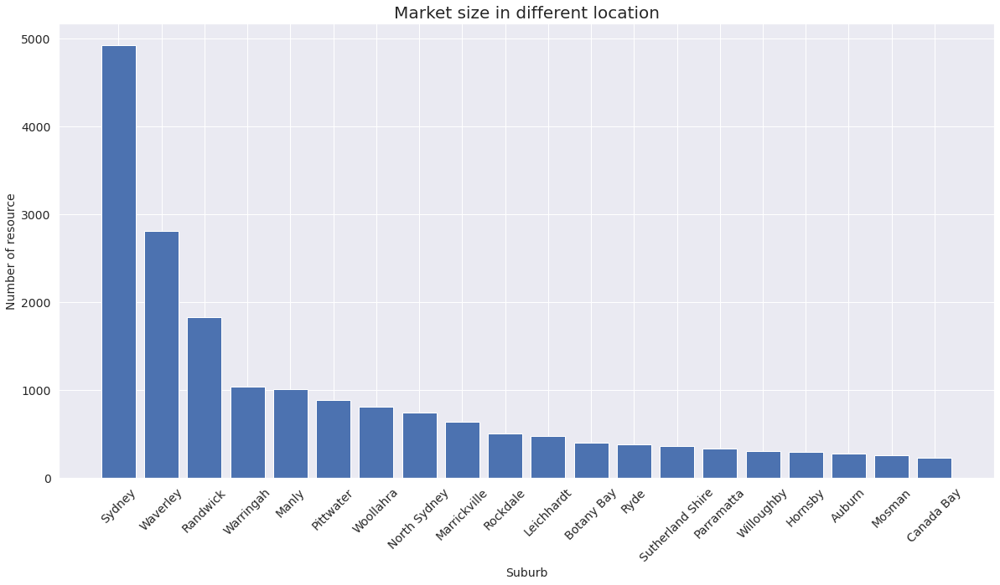

In [241]:
sns.set_theme(style="darkgrid")
plt.figure(figsize=(20,10))
plt.bar(market_size_bar.neighbourhood,market_size_bar.name,color='b')
plt.title('Market size in different location', fontsize=20)
plt.xlabel('Suburb', fontsize=14)
plt.ylabel('Number of resource', fontsize=14)
plt.tick_params(labelsize=14)
plt.xticks(rotation=45)
# for a,b in zip(count_by_location.index, count_by_location.values):
#     plt.text(a, b+5, b, fontsize=10, ha='center')
plt.show()

### Room type and price relationship

### Compare the average price in location by room type

In [242]:
roomtype_price = df_list.copy()

entire_price = roomtype_price.drop(roomtype_price[roomtype_price['room_type']!='Entire home/apt'].index)
entire = entire_price[['neighbourhood','price']]
entire_mean = entire.groupby('neighbourhood')['price'].agg(['mean']).round(2).reset_index()
entire_mean = entire_mean.sort_values(by = ['mean'])
entire_mean_topk = entire_mean.nlargest(20, 'mean')
entire_mean_topk.rename(columns={'neighbourhood':'Location', 'mean':'Average Price'}, inplace = True)

private_price = roomtype_price.drop(roomtype_price[roomtype_price['room_type']!='Private room'].index)
private = private_price[['neighbourhood','price']]
private_mean = private.groupby('neighbourhood')['price'].agg(['mean']).round(2).reset_index()
private_mean = private_mean.sort_values(by = ['mean'])
private_mean_topk = private_mean.nlargest(20, 'mean')
private_mean_topk.rename(columns={'neighbourhood':'Location', 'mean':'Average Price'}, inplace = True)

hotel_price = roomtype_price.drop(roomtype_price[roomtype_price['room_type']!='Hotel room'].index)
hotel = hotel_price[['neighbourhood','price']]
hotel_mean = hotel.groupby('neighbourhood')['price'].agg(['mean']).round(2).reset_index()
hotel_mean = hotel_mean.sort_values(by = ['mean'])
hotel_mean_topk = hotel_mean.nlargest(20, 'mean')
hotel_mean_topk.rename(columns={'neighbourhood':'Location', 'mean':'Average Price'}, inplace = True)

shared_price = roomtype_price.drop(roomtype_price[roomtype_price['room_type']!='Shared room'].index)
shared = shared_price[['neighbourhood','price']]
shared_mean = shared.groupby('neighbourhood')['price'].agg(['mean']).round(2).reset_index()
shared_mean = shared_mean.sort_values(by = ['mean'])
shared_mean_topk = shared_mean.nlargest(20, 'mean')
shared_mean_topk.rename(columns={'neighbourhood':'Location', 'mean':'Average Price'}, inplace = True)

<AxesSubplot:title={'center':'Shared room Price in different location'}, xlabel='Location', ylabel='Average Price'>

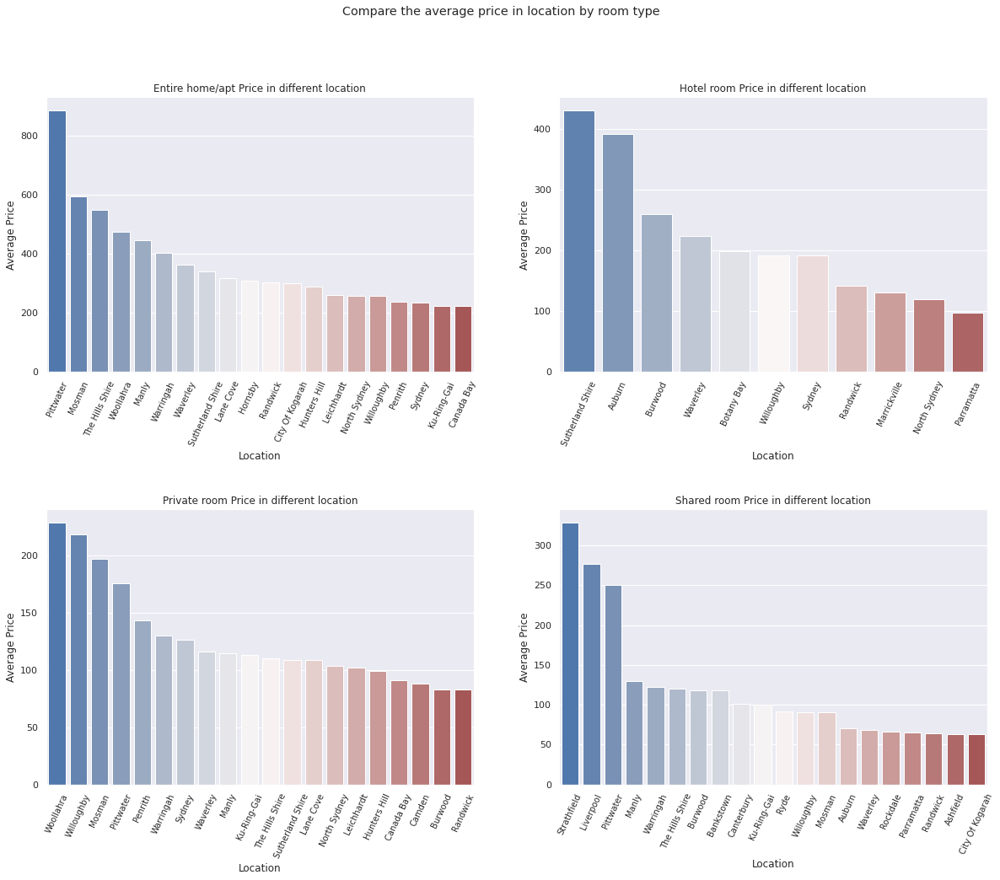

In [243]:
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20, 15))
fig.suptitle('Compare the average price in location by room type')
fig.subplots_adjust(hspace=0.5)
ax0 = axs[0,0]
ax0.set_xticklabels(entire_mean_topk['Location'],rotation = 65,fontsize = 'small')
ax0.set_title('Entire home/apt Price in different location')
ax0.get_yaxis().get_major_formatter().set_scientific(False)
ax1 = axs[1,0]
ax1.set_xticklabels(private_mean_topk['Location'],rotation = 65,fontsize = 'small')
ax1.get_yaxis().get_major_formatter().set_scientific(False)
ax1.set_title('Private room Price in different location')
ax2 = axs[0,1]
ax2.set_xticklabels(hotel_mean_topk['Location'],rotation = 65,fontsize = 'small')
ax2.get_yaxis().get_major_formatter().set_scientific(False)
ax2.set_title('Hotel room Price in different location')
ax3 = axs[1,1]
ax3.set_xticklabels(shared_mean_topk['Location'],rotation = 65,fontsize = 'small')
ax3.get_yaxis().get_major_formatter().set_scientific(False)
ax3.set_title('Shared room Price in different location')

     
sns.barplot(x="Location", y="Average Price", data=entire_mean_topk, palette="vlag", ax = ax0)
sns.barplot(x="Location", y="Average Price", data=private_mean_topk, palette="vlag", ax = ax1)
sns.barplot(x="Location", y="Average Price", data=hotel_mean_topk, palette="vlag", ax = ax2)
sns.barplot(x="Location", y="Average Price", data=shared_mean_topk, palette="vlag", ax = ax3)

### Use Heat Map to Analysis average price, total count of rooms relate to location.

In [244]:
syd_region = geopandas.read_file("neighbourhoods.geojson")

In [245]:
syd_region.head()

,neighbourhood,neighbourhood_group,geometry
0,Pittwater,None,"MULTIPOLYGON (((151.29613 -33.57292, 151.29618..."
1,Randwick,None,"MULTIPOLYGON (((151.23722 -33.89075, 151.23731..."
2,Waverley,None,"MULTIPOLYGON (((151.28337 -33.86183, 151.28334..."
3,Warringah,None,"MULTIPOLYGON (((151.21140 -33.61521, 151.21157..."
4,Lane Cove,None,"MULTIPOLYGON (((151.16634 -33.80621, 151.16650..."


In [246]:
Property_map_summary = df_list[['neighbourhood','price','room_type','name']].groupby(['neighbourhood','room_type']).agg({'price':'mean','name':'count'}).round(2)

In [247]:
Property_map_summary.head()

price  name
neighbourhood room_type                    
Ashfield      Entire home/apt  167.64    81
              Private room      64.08    80
              Shared room       62.67     6
Auburn        Entire home/apt  194.29   160
              Hotel room       391.60     5

In [248]:
# extract room type as Entire home/apt
entire_df = Property_map_summary.loc[(slice(None),'Entire home/apt'),:].reset_index()
entire_df.drop('room_type',axis=1,inplace=True)
entire_df.rename(columns={'neighbourhood':'Location', 'price':'Average_Price','name':'Total_Count'}, inplace = True)

# extract property type as Private room
private_df = Property_map_summary.loc[(slice(None),'Private room'),:].reset_index()
private_df.drop('room_type',axis=1,inplace=True)
private_df.rename(columns={'neighbourhood':'Location', 'price':'Average_Price','name':'Total_Count'}, inplace = True)

# extract property type as Hotel room
hotel_df = Property_map_summary.loc[(slice(None),'Hotel room'),:].reset_index()
hotel_df.drop('room_type',axis=1,inplace=True)
hotel_df.rename(columns={'neighbourhood':'Location', 'price':'Average_Price','name':'Total_Count'}, inplace = True)

# extract property type as Shared room
share_df = Property_map_summary.loc[(slice(None),'Shared room'),:].reset_index()
share_df.drop('room_type',axis=1,inplace=True)
share_df.rename(columns={'neighbourhood':'Location', 'price':'Average_Price','name':'Total_Count'}, inplace = True)

In [249]:
def draw_plotmap_num(df,t):    
    map= px.choropleth_mapbox(
                    data_frame=df,
                    geojson=syd_region,
                    color='Average_Price',
                    locations='Location', 
                    featureidkey='properties.neighbourhood',
                    mapbox_style="carto-positron",
                    color_continuous_scale='viridis',
                    center={"lat": -33.86934, "lon": 151.22688},
                    hover_data={'Location','Total_Count'},
                    opacity=0.7,
                    zoom=8,
                    title=t + ' -Average price in Sydney',#map title
    )
   
    map.update_layout(margin=dict(
        l=0,
        r=0,
        b=50,
        t=30,
    ),height=600,width=900)
    
    map.show()

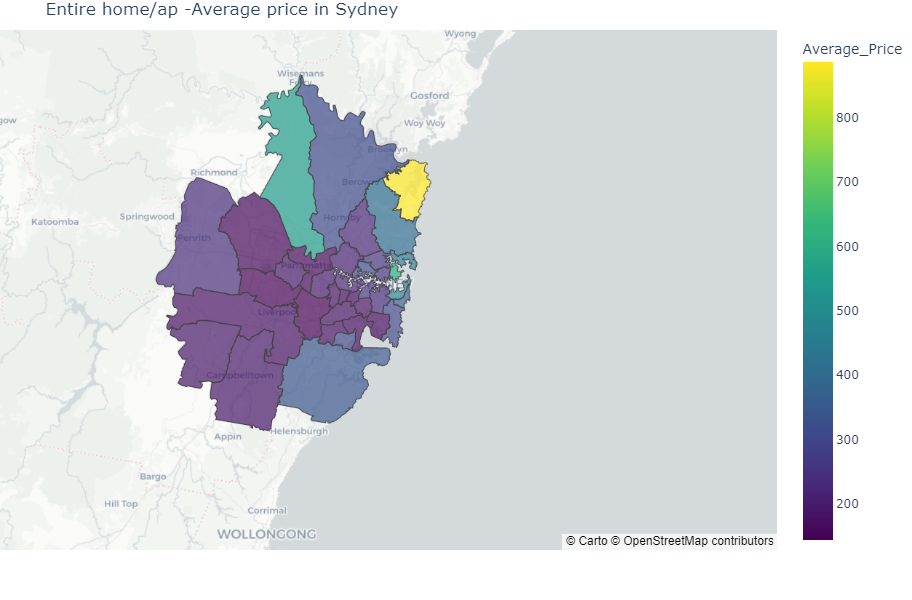

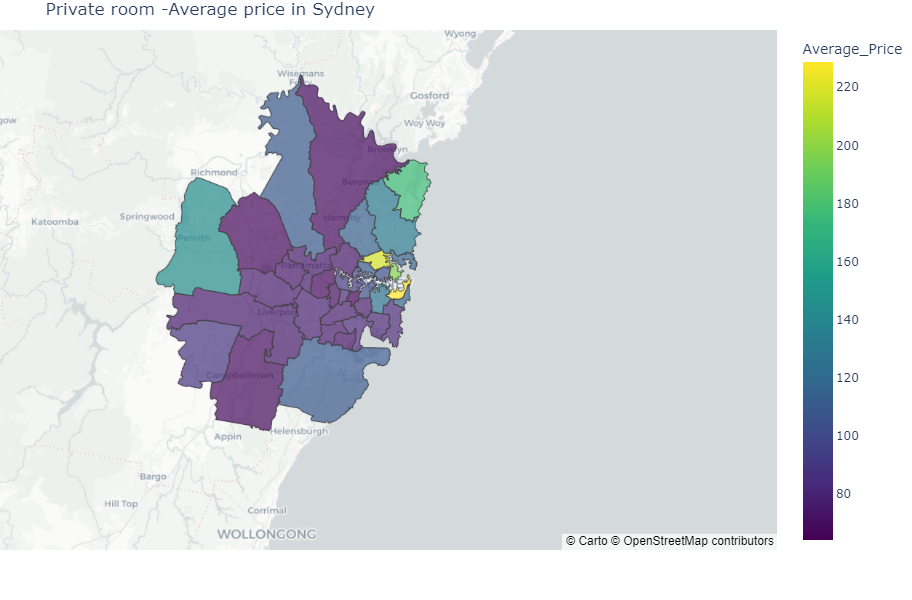

In [251]:
draw_plotmap_num(entire_df,'Entire home/ap')
draw_plotmap_num(private_df,'Private room')
# draw_plotmap_num(hotel_df,'Hotel room')
# draw_plotmap_num(share_df,'Shared room')

### Analysis relationship between popularity and price --popularity rely on the number of reviews

In [252]:
popular_price = df_list[['neighbourhood','name','room_type','price','number_of_reviews']]

In [253]:
popular_price.head()

,neighbourhood,name,room_type,price,number_of_reviews
0,Sydney,An Oasis in the City,Private room,65,196
1,Manly,Manly Harbour House,Entire home/apt,470,3
2,Sydney,Unique Designer Rooftop Apartment in City Loca...,Private room,88,389
3,Sydney,Sunny Darlinghurst Warehouse Apartment,Entire home/apt,130,76
4,Mosman,"Studio Yindi @ Mosman, Sydney",Entire home/apt,150,303


In [254]:
popular_price.isnull().sum()

neighbourhood        0
name                 7
room_type            0
price                0
number_of_reviews    0
dtype: int64

In [255]:
popular_price['name'].fillna(value = 'unknown', inplace = True)

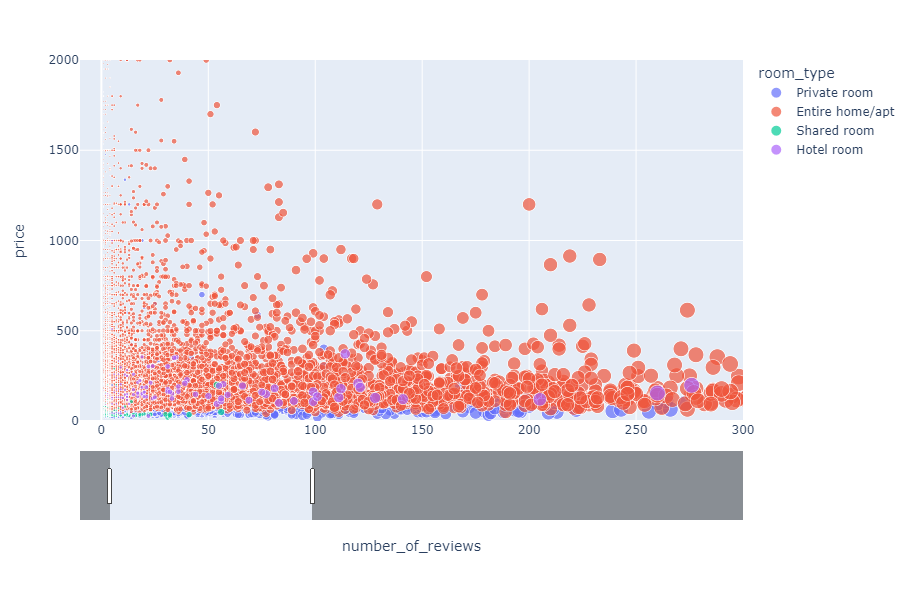

In [256]:
# relationships between property age and selling prices

fig_age = px.scatter(popular_price, x='number_of_reviews', y='price', color='room_type',
                     size='number_of_reviews', hover_data=['neighbourhood','price','name','number_of_reviews'],
                     range_x=[-10,300], range_y=[0,2000]
                   )
fig_age.update_layout(
                        autosize=False,
                        width=900,
                        height=600,
                    )
fig_age.update_layout(xaxis=dict(rangeslider=dict(visible=True)),
                      #yaxis=dict(rangeslider=dict(visible=True)),
                     dragmode="zoom"
                     )
                    
fig_age.show()

### From this analysis, it shows most popular room, the price usually below '$500', and the location is not far away form city.

### Each location's airbnb room price range --base on the above analysis, we just choose price above $500 itmes.

In [257]:
price_range = df_list[['neighbourhood','name','room_type','price']]
price_range = price_range.loc[price_range.price<500,:]

In [258]:
price_range_entire = price_range.loc[price_range['room_type'].str.contains('Entire home/apt'), :]
price_range_private = price_range.loc[price_range['room_type'].str.contains('Private room'), :]
price_range_hotel = price_range.loc[price_range['room_type'].str.contains('Hotel room'), :]
price_range_share = price_range.loc[price_range['room_type'].str.contains('Shared room'), :]

In [259]:
price_range_entire_count = price_range_entire[['neighbourhood','name']]
price_range_entire_count = price_range_entire_count.groupby('neighbourhood').count().reset_index()
price_range_entire_count = price_range_entire_count.nlargest(20, 'name')

price_range_private_count = price_range_private[['neighbourhood','name']]
price_range_private_count = price_range_private_count.groupby('neighbourhood').count().reset_index()
price_range_private_count = price_range_private_count.nlargest(20, 'name')

price_range_hotel_count = price_range_hotel[['neighbourhood','name']]
price_range_hotel_count = price_range_hotel_count.groupby('neighbourhood').count().reset_index()
price_range_hotel_count = price_range_hotel_count.nlargest(20, 'name')

price_range_share_count = price_range_share[['neighbourhood','name']]
price_range_share_count = price_range_share_count.groupby('neighbourhood').count().reset_index()
price_range_share_count = price_range_share_count.nlargest(20, 'name')

In [260]:
# anaslys top k Suburb price, top k rely on the count of on sale property

price_range_entire_top = price_range_entire_count.merge(price_range_entire,on='neighbourhood', how='left')
price_range_private_top = price_range_private_count.merge(price_range_private,on='neighbourhood', how='left')
price_range_hotel_top = price_range_hotel_count.merge(price_range_hotel,on='neighbourhood', how='left')
price_range_share_top = price_range_share_count.merge(price_range_share,on='neighbourhood', how='left')

<AxesSubplot:title={'center':'Shared room Price in different location'}, xlabel='neighbourhood', ylabel='price'>

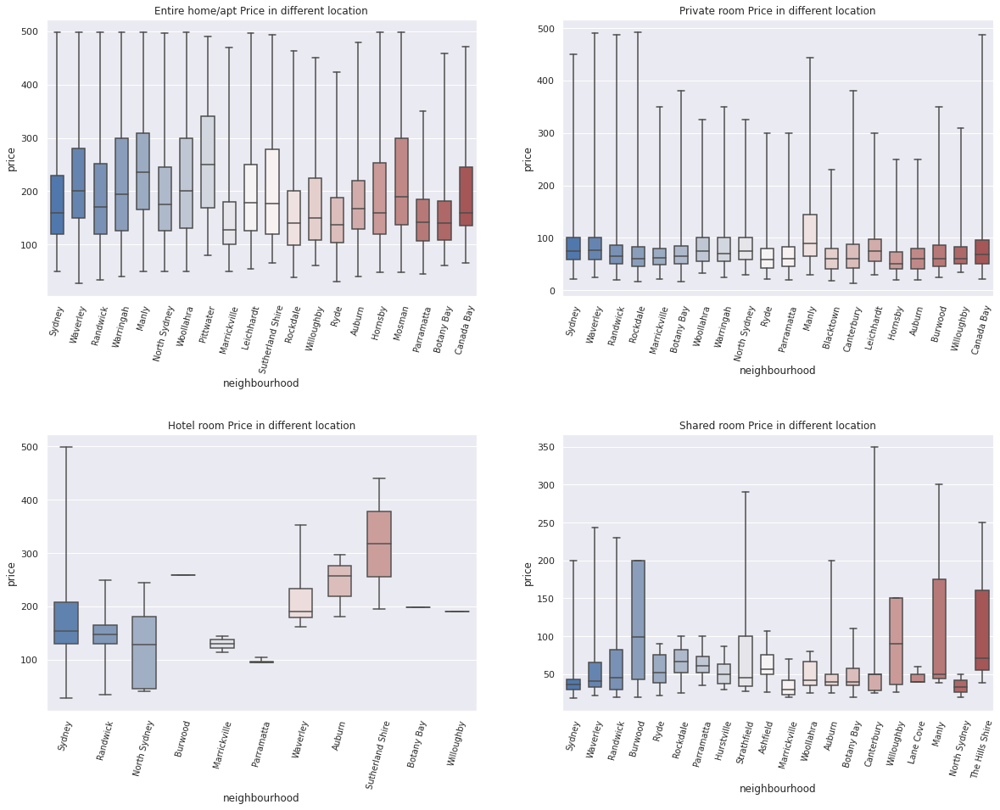

In [261]:
fig, axs = plt.subplots(nrows=2, ncols=2,figsize=(20, 15))
fig.subplots_adjust(hspace=0.5)

ax0 = axs[0,0]
ax0.set_xticklabels(price_range_entire_top['neighbourhood'],rotation = 75,fontsize = 'small')
ax0.set_title('Entire home/apt Price in different location')
ax0.get_yaxis().get_major_formatter().set_scientific(False)
ax1 = axs[0,1]
ax1.set_xticklabels(price_range_private_top['neighbourhood'],rotation = 75,fontsize = 'small')
ax1.get_yaxis().get_major_formatter().set_scientific(False)
ax1.set_title('Private room Price in different location')
ax2 = axs[1,0]
ax2.set_xticklabels(price_range_hotel_top['neighbourhood'],rotation = 75,fontsize = 'small')
ax2.get_yaxis().get_major_formatter().set_scientific(False)
ax2.set_title('Hotel room Price in different location')
ax3 = axs[1,1]
ax3.set_xticklabels(price_range_share_top['neighbourhood'],rotation = 75,fontsize = 'small')
ax3.get_yaxis().get_major_formatter().set_scientific(False)
ax3.set_title('Shared room Price in different location')

sns.boxplot(x="neighbourhood", y="price", data=price_range_entire_top, whis=[0, 100], width=.6, palette="vlag", ax = ax0)
sns.boxplot(x="neighbourhood", y="price", data=price_range_private_top, whis=[0, 100], width=.6, palette="vlag",ax = ax1)
sns.boxplot(x="neighbourhood", y="price", data=price_range_hotel_top, whis=[0, 100], width=.6, palette="vlag", ax = ax2)
sns.boxplot(x="neighbourhood", y="price", data=price_range_share_top, whis=[0, 100], width=.6, palette="vlag", ax = ax3)

### For the analysis of market size, It shows the Sydney city area has the most airbnb rooms for booking，so I will choose this area to do an analysis -- room type and price relationship

### Analysis room type and booking price relationship

In [262]:
df_sydney = df_list[df_list['neighbourhood']=='Sydney']
df_sydney = df_sydney.loc[df_sydney1.price<500,:]

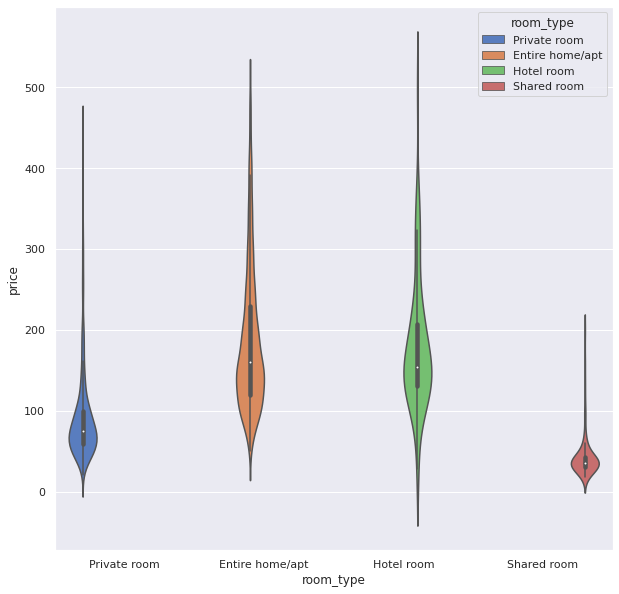

In [263]:
fig_type, ax_type = plt.subplots(figsize=(10,10))
ax_type=sns.violinplot(x=df_sydney['room_type'],y=df_sydney['price'],hue=df_sydney['room_type'],palette="muted")